<a href="https://colab.research.google.com/github/rhaymisonbetini/notebook_for_audio_process/blob/main/carregamento_processamento_audio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*
Carregamento e processamento audio

In [ ]:
import numpy as np
import math
import librosa
import librosa.display as ld
import seaborn as sn
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (14, 6)
from IPython.display import Audio, HTML
sn.set()

* Carregamento de Audio Mono com mono_data e amostragem

In [ ]:
librosa.util.list_examples()

AVAILABLE EXAMPLES
--------------------------------------------------------------------
brahms    	Brahms - Hungarian Dance #5
choice    	Admiral Bob - Choice (drum+bass)
fishin    	Karissa Hobbs - Let's Go Fishin'
humpback  	Glacier Bay 60-second clip humpback whale song November 2020
libri1    	Ashiel Mystery - A Detective Story, chapter 2, narrated by Garth Comira
libri2    	The Age of Chivalry / Chapter 18: Perceval / Read by Anders Lankford
libri3    	Sense and Sensibility / Chapter 18 / Jane Austen / Read by Heather Barnett
nutcracker	Tchaikovsky - Dance of the Sugar Plum Fairy
pistachio 	The Piano Lady - Pistachio Ice Cream Ragtime
robin     	Bird Whistling, Robin, Single, 13.wav / InspectorJ
sweetwaltz	Setuniman - Sweet Waltz
trumpet   	Mihai Sorohan - Trumpet loop
vibeace   	Kevin MacLeod - Vibe Ace


Carregando o audio com seus dados e sua taxa de amostragem

In [ ]:
filename = librosa.util.example('fishin')
mono_data, sample_rate = librosa.load(filename, duration=60)

In [ ]:
print('Vetor :', mono_data)
print('Vetor :', mono_data.shape)

Vetor : [ 1.9766041e-08 -1.0022914e-05  1.5472586e-05 ... -8.9414477e-02
 -8.2009345e-02 -4.6974115e-02]
Vetor : (1323000,)


In [ ]:
print('Vetor :', sample_rate)

Vetor : 22050


In [ ]:
Audio(mono_data, rate=sample_rate)

* Carregamento de audo estereo

In [ ]:
filename = librosa.util.ex('brahms', hq=True)
stereo_data, sample_rate = librosa.load(filename, duration=60, mono=False)

In [ ]:
print('Vetor :', stereo_data)
print('Vetor :', stereo_data.shape)

Vetor : [[ 2.8887825e-10  6.0242655e-10  9.7486463e-10 ...  0.0000000e+00
   0.0000000e+00  0.0000000e+00]
 [ 2.8342129e-10  3.2150638e-10 -5.3444182e-10 ...  0.0000000e+00
   0.0000000e+00  0.0000000e+00]]
Vetor : (2, 1010880)


In [ ]:
print('Vetor :', sample_rate)

Vetor : 22050


* Separação harmonico percusivo

In [ ]:
filename = librosa.util.ex('nutcracker')
y, sr = librosa.load(filename)
y_harmonic, y_percussive = librosa.effects.hpss(y)

In [ ]:
print("Taxa de amostragem: ", sr)
print("Quantidade de amostras: ", len(y))
print("Duração: ", librosa.get_duration(y=y, sr=sr))
print("Canais: ", y.shape)

Taxa de amostragem:  22050
Quantidade de amostras:  2643264
Duração:  119.87591836734694
Canais:  (2643264,)


* Som harmonico

In [ ]:
Audio(data=y_harmonic, rate=sr)

* Som percussivo

In [ ]:
Audio(data=y_percussive, rate=sr)

* Detecção de inicio e picos de audio

In [ ]:
y, sr = librosa.load(librosa.ex('trumpet'))
onset_env = librosa.onset.onset_strength(y=y, sr=sr, max_size=5)
onset_env.shape, type(onset_env)

((230,), numpy.ndarray)

In [ ]:
times = librosa.times_like(onset_env, sr=sr)

In [ ]:
times.shape, type(times)

((230,), numpy.ndarray)

In [ ]:
onset_frames = librosa.onset.onset_detect(onset_envelope=onset_env, sr=sr)

In [ ]:
onset_frames

array([  3,  11,  26,  40,  48,  61,  88, 102, 110])

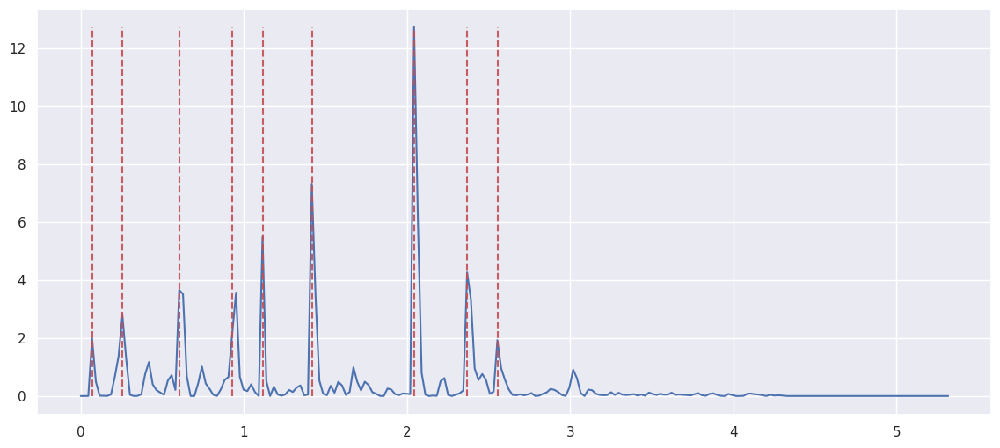

In [ ]:
plt.plot(times, onset_env, label = "Onset Strength")
plt.vlines(times[onset_frames], 0, onset_env.max(), color='r', alpha=0.9,
           linestyle='--', label='Onsets')

In [ ]:
y_clicks = librosa.clicks(times=times[onset_frames], sr=sr, length=len(y))

In [ ]:
Audio(data=y_clicks, rate=sr)

* Visualizando gráficos de ondas ( Wave Plots )

Text(0.5, 1.0, 'Wave Plot')

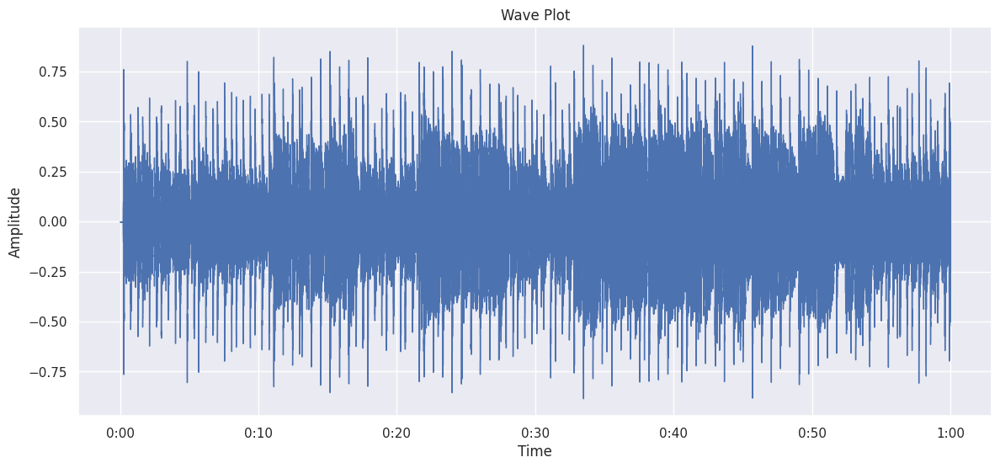

In [ ]:
ld.waveshow(y=mono_data, sr= sample_rate)
plt.ylabel('Tempo')
plt.ylabel('Amplitude')
plt.title('Wave Plot')

In [ ]:
onset_env_mono = librosa.onset.onset_strength(y=mono_data, sr=sample_rate, max_size=5)

In [ ]:
times_mono = librosa.times_like(onset_env_mono, sr=sample_rate)

In [ ]:
onset_frames_mono = librosa.onset.onset_detect(onset_envelope=onset_env_mono, sr=sample_rate)

In [ ]:
times.shape, onset_frames_mono

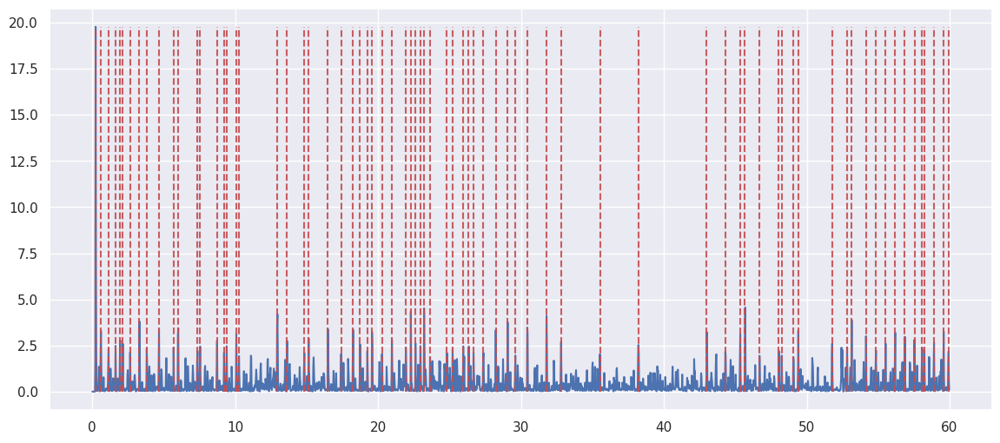

In [ ]:
plt.plot(times_mono, onset_env_mono, label="Onset Strength")
plt.vlines(times_mono[onset_frames_mono], 0, onset_env_mono.max(), color='r', alpha=0.9,
           linestyle='--', label='Onsets')

In [ ]:
y_clicks_mono = librosa.clicks(times=times_mono[onset_frames_mono], sr=sample_rate, length=len(mono_data))

In [ ]:
Audio(data=y_clicks_mono, rate=sample_rate)

# Transformada de Fourier

* Os quadros divididos pala amostragem fornecem exatamente o tempo de duração do audio



In [ ]:
y, sr = librosa.load(librosa.ex('trumpet'))
print("Duração: ", len(y)/sr)
print("Quadros/amostras", len(y))
print("Taxa de amostragem: ", sr)

Duração:  5.333378684807256
Quadros/amostras 117601
Taxa de amostragem:  22050


* 512 é o comprimento do salto
* 2048 tamanho do quadro

Será gerado uma matrix de 1025 linhas por 230 colunas

In [ ]:
hop_length = 512
n_fft = 2048
D = librosa.stft(y, hop_length=hop_length, n_fft=n_fft)
D.shape

(1025, 230)

* Valores de Quadros e valores de saltos em segundos

In [ ]:
print("n_fft em segundos: ", n_fft/sr)
print("hop_length em segundos: ", hop_length/sr)

n_fft em segundos:  0.09287981859410431
hop_length em segundos:  0.023219954648526078


# Espectograma

Audio humano segue a escala logaritmica.


1.   Obter o sinal de audio
2.   Separar o sinal em quadros
3.   Para cada quadro aplicar a transformada de Fourier
4.   Criar matriz cujas colunas sao as transformações
5.   Traçar o mapa de calor da Matriz



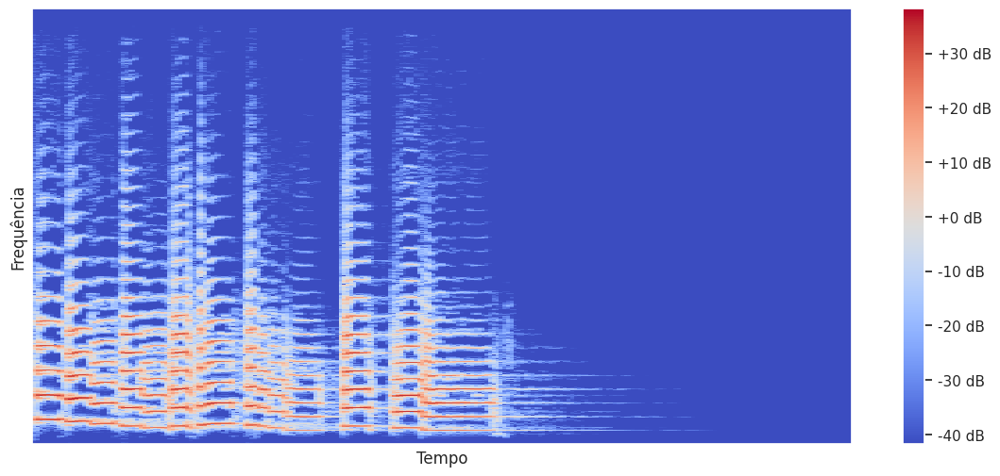

In [ ]:
# Sequencia linear
S = librosa.amplitude_to_db(abs(D))
ld.specshow(S, sr=sr, hop_length=hop_length)
plt.ylabel('Frequência')
plt.xlabel('Tempo')
plt.colorbar(format="%+2.0f dB")

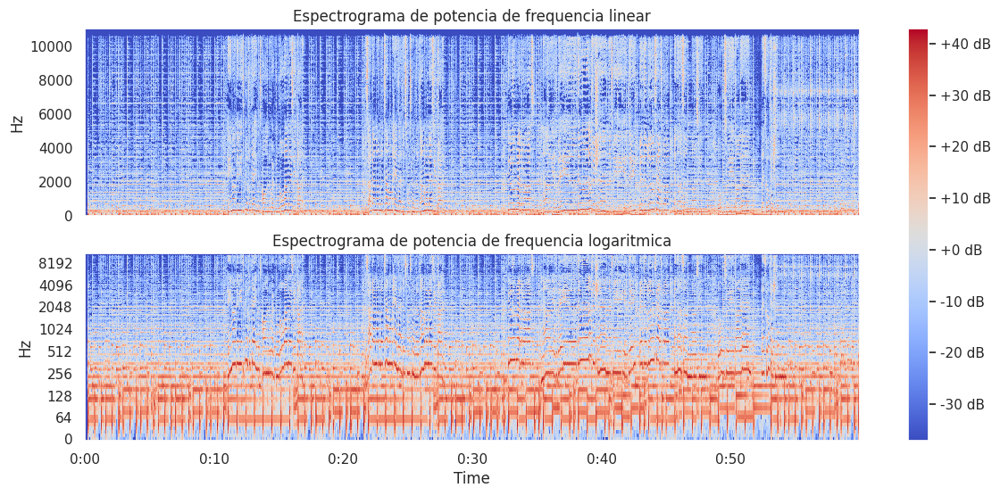

In [ ]:
# Sequencia logaritmica
d = librosa.stft(mono_data)
D =  librosa.amplitude_to_db(abs(d))
fig, ax = plt.subplots(2,1)
img = ld.specshow(D, sr=sample_rate, x_axis='time', y_axis='linear', ax=ax[0])
ax[0].set(title="Espectrograma de potencia de frequencia linear")
ax[0].label_outer()
ld.specshow(D, y_axis="log", x_axis='time', ax=ax[1])
ax[1].set(title="Espectrograma de potencia de frequencia logaritmica")
ax[1].label_outer()
fig.colorbar(img, ax=ax, format="%+2.0f dB")

# Frequencia MEL
Escala ideal para aprendizagem de maquina

In [ ]:
def freq_to_mel(freq):
    return 1127 * math.log(1 + freq/700)

In [ ]:
mel = np.vectorize(freq_to_mel)
Hz = np.linspace(0,1e4)
print(Hz)
mel = mel(Hz)
print(mel)

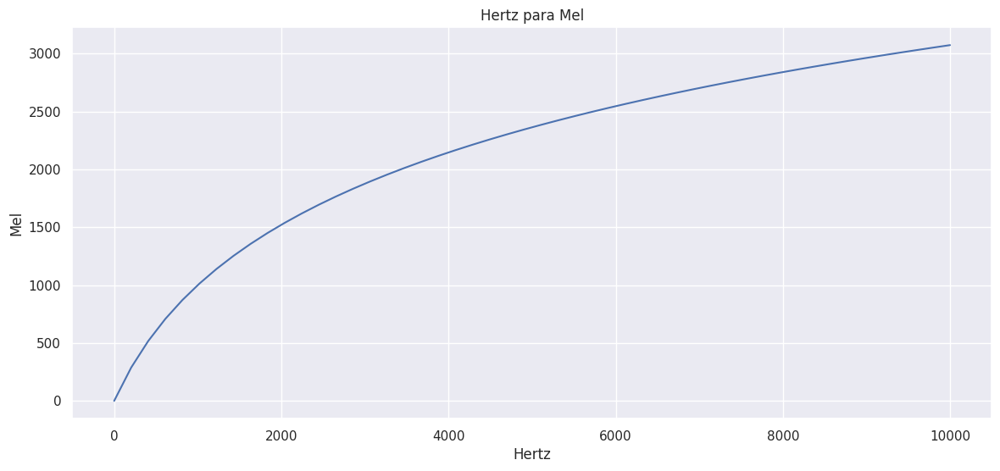

In [ ]:
plt.title("Hertz para Mel")
plt.xlabel("Hertz")
plt.ylabel("Mel")
plt.plot(Hz, mel)

In [ ]:
data, sample_rate = librosa.load(librosa.ex('brahms'), duration=10)

In [ ]:
Audio(data,rate =sample_rate)

In [ ]:
mfccs = librosa.feature.mfcc(y=data, sr=sample_rate)
mfccs.shape, type(mfccs)

((20, 431), numpy.ndarray)

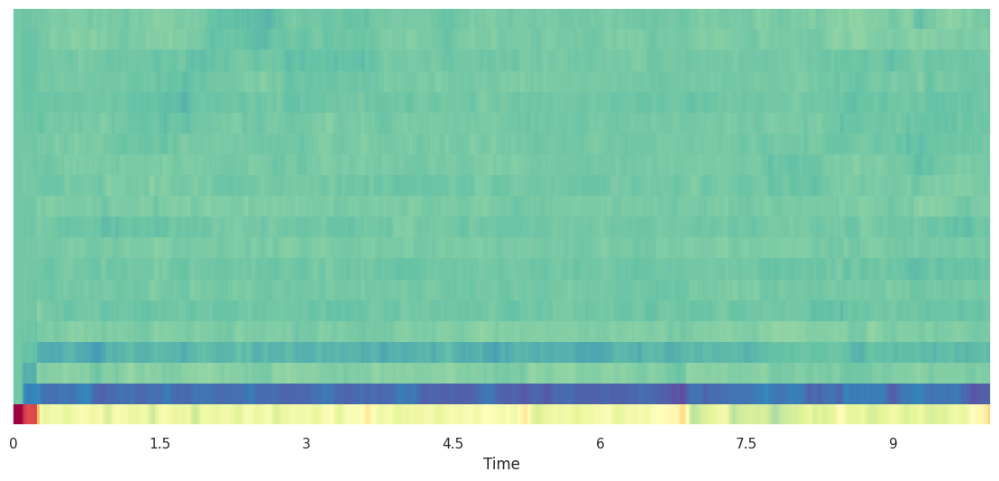

In [ ]:
ld.specshow(mfccs, sr=sample_rate, x_axis='time', cmap='Spectral')

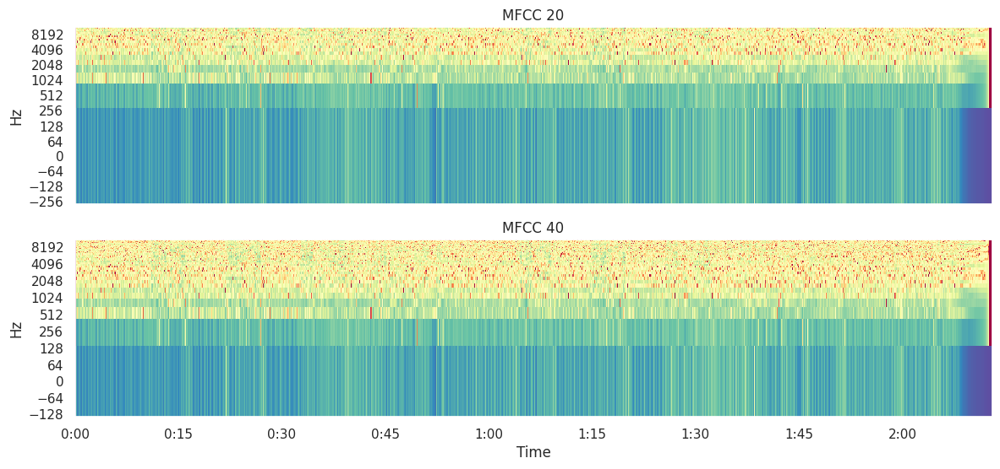

In [ ]:
data, sample_rate = librosa.load(librosa.ex('fishin'))
mfcc20 = librosa.feature.mfcc(y=data, sr=sample_rate, n_mfcc=20)
mfcc40 = librosa.feature.mfcc(y=data, sr=sample_rate, n_mfcc=40)

mfcc20_db = librosa.amplitude_to_db(mfcc20)
mfcc40_db = librosa.amplitude_to_db(mfcc40)

fig, ax = plt.subplots(2,1)
ld.specshow(mfcc20_db, sr=sample_rate, x_axis='time', cmap='Spectral', ax=ax[0], y_axis = "log")
ld.specshow(mfcc40_db, sr=sample_rate, x_axis='time', cmap='Spectral', ax=ax[1], y_axis = "log")
ax[0].set(title='MFCC 20')
ax[0].label_outer()
ax[1].set(title='MFCC 40')
ax[ 1  ].label_outer()



In [ ]:
data, sample_rate = librosa.load(librosa.ex('fishin'))
mfccs = librosa.feature.mfcc(y=data, sr=sample_rate, n_mfcc=40)
mfccs.shape

(40, 5728)

Calculando a media do valor de cada linha

In [ ]:
mfcss_scaled_features = np.mean(mfccs.T,axis=0)
mfcss_scaled_features.shape

(40,)

In [ ]:
mfcss_scaled_features

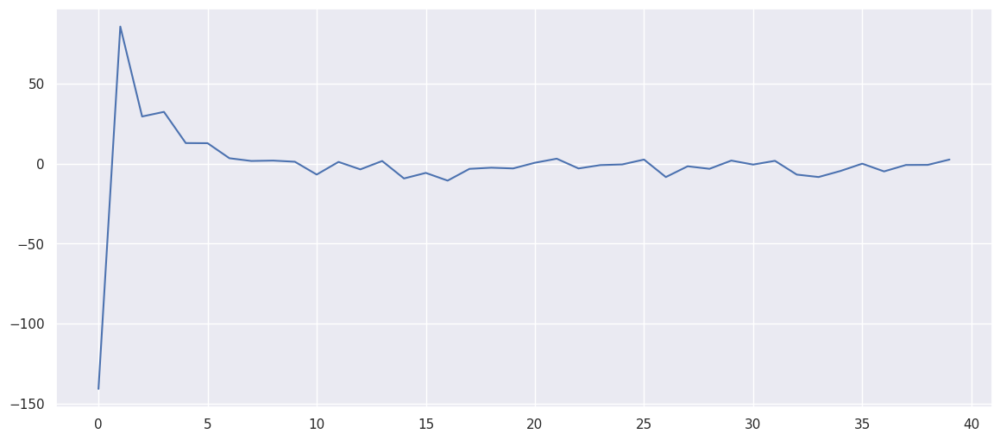

In [ ]:
plt.plot(mfcss_scaled_features)

# Classificação de sons ambientais

In [36]:
import os
import pathlib
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import librosa.display
import librosa
import numpy as np
import pandas as pd
from datetime import datetime
from IPython.display import Audio
from tqdm import tqdm
import tensorflow
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv1D, MaxPooling1D
from tensorflow.keras.callbacks import ModelCheckpoint
import seaborn as sns
sns.set()

In [2]:
!wget https://zenodo.org/records/1203745/files/UrbanSound8K.tar.gz -O UrbanSound8K.tar.gz

--2024-01-06 12:15:43--  https://zenodo.org/records/1203745/files/UrbanSound8K.tar.gz
Resolving zenodo.org (zenodo.org)... 188.185.79.172, 188.184.103.159, 188.184.98.238, ...
Connecting to zenodo.org (zenodo.org)|188.185.79.172|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6023741708 (5.6G) [application/octet-stream]
Saving to: ‘UrbanSound8K.tar.gz’

UrbanSound8K.tar.gz 100%[===================>]   5.61G  14.1MB/s    in 6m 57s  

2024-01-06 12:22:42 (13.8 MB/s) - ‘UrbanSound8K.tar.gz’ saved [6023741708/6023741708]



In [3]:
!tar -xzf UrbanSound8K.tar.gz

In [37]:
metadata = pd.read_csv('UrbanSound8K/metadata/UrbanSound8K.csv')
metadata.head()

,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.0,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.5,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.5,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.0,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.5,72.500000,1,5,2,children_playing


In [ ]:
fsId = []
classId =[]
occurId =[]
sliceId = []
full_path = []


for root, dirs, files in tqdm(os.walk('UrbanSound8K/audio/')):
# print(root) # pastas
# print(dirs) # nomes das pastas
# xprint(files) # arquivos dentro de cada pasta

  for file in files:
    try:
      fs = file.split('-')
      fsId.append(int(fs[0]))
      classId.append(int(fs[1]))
      occurId.append(int(fs[2]))
      sliceId.append(int(fs[3].split('.')[0]))
      full_path.append(os.path.join(root, file))
    except ValueError:
      continue

print(len(fsId))
print(len(classId))
print(len(occurId))
print(len(sliceId))
print(len(full_path))
print(fsId)
print(classId)
print(sliceId)
print(occurId)
print(sliceId)
print(full_path)

In [ ]:
sound_list = ['air_conditioner','car_horn','children_playing','dog_bark','drilling','engine_idling','gun_shot','jackhammer','siren','street_music']
sound_dic = {em[0]: em[1] for em in enumerate(sound_list)}
sound_dic

In [ ]:
df = pd.DataFrame([fsId,classId,occurId,sliceId,full_path]).T
df.columns = ['fsId','classId','occurId','sliceId','full_path']
df['classId'] = df['classId'].map(sound_dic)
df['path'] = df['full_path'].apply(lambda x: x.split('/')[1])
df.head()

In [ ]:
df.describe(), df['classId'].value_counts()

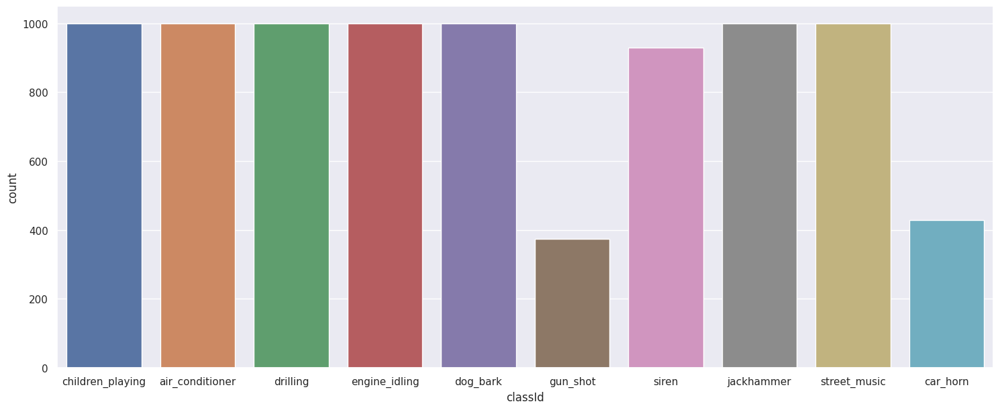

In [42]:
plt.figure(figsize=(18,7))
sns.countplot(x='classId', data=df)
plt.show()


<Figure size 1800x700 with 0 Axes>

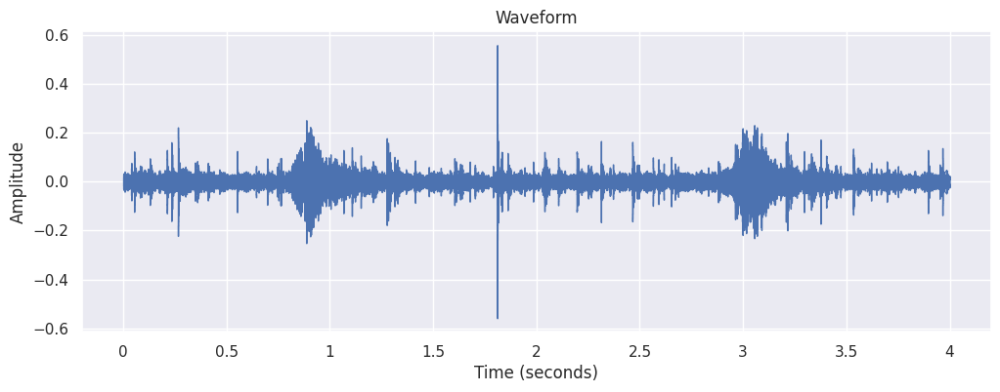

In [43]:
n_files = df.shape[0]
rnd = np.random.randint(0,n_files)
filename = df['full_path'][rnd]
Audio(filename, autoplay=True) # Selecionando audios aleatorios
data, sample_rate = librosa.load(filename)
plt.figure(figsize=(18,7))
plt.figure(figsize=(12, 4))
librosa.display.waveshow(data, sr=sample_rate)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitude')
plt.show()

# Espectograma para caracteristicas de ML

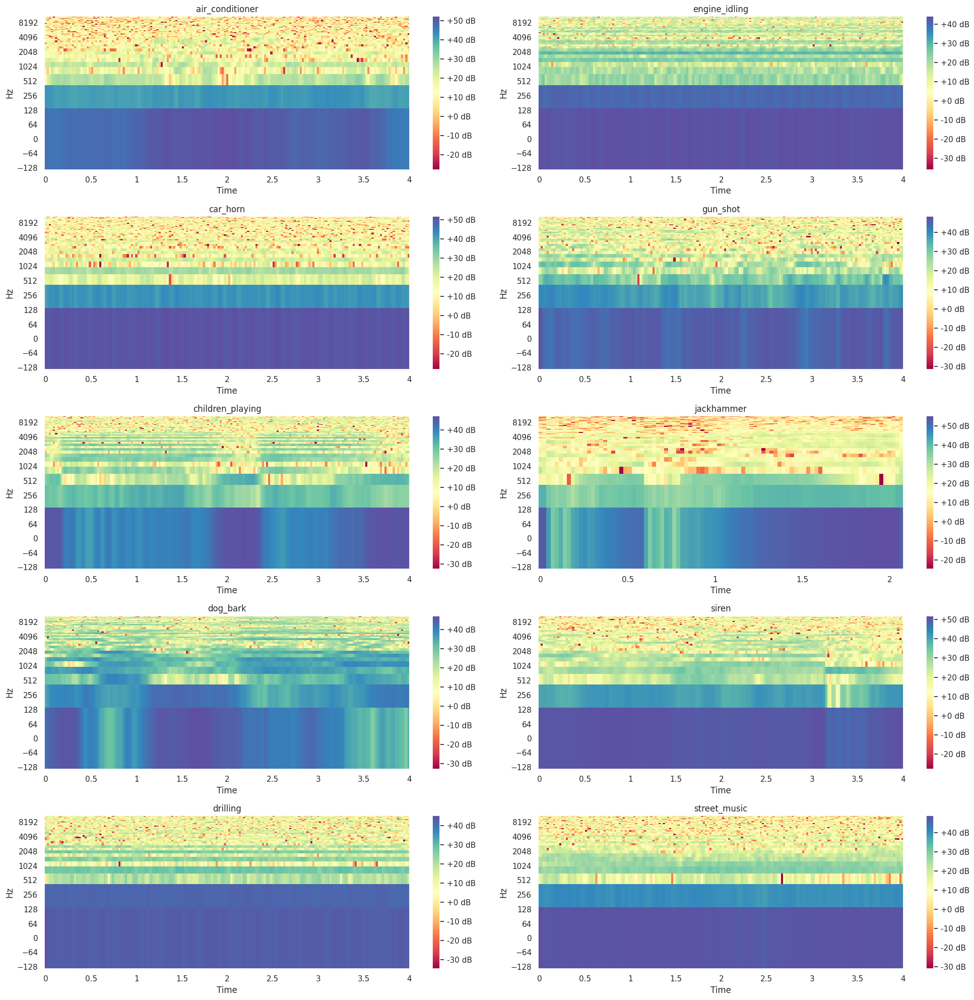

In [44]:
random_sample = df.groupby('classId').sample(n=1)
audio_samples, labels = random_sample['path'].tolist(), random_sample['classId'].tolist()

rows = 5
cols = 2

fig, axs = plt.subplots(rows, cols, figsize=(20, 20))
index = 0
for col in range(cols):
    for row in range(rows):
        data, sample_rate = librosa.load(df['full_path'][index])
        mfccs = librosa.feature.mfcc(y=data, sr=sample_rate, n_mfcc=40)
        mfccs_db = librosa.amplitude_to_db(np.abs(mfccs))
        img = librosa.display.specshow(mfccs_db, x_axis='time', y_axis='log', ax=axs[row][col], cmap='Spectral')
        axs[row, col].set_title('{}'.format(labels[index]))
        fig.colorbar(img, ax=axs[row, col], format="%+2.0f dB")
        index += 1

fig.tight_layout()
plt.show()


In [45]:
def feature_extractor(file_name):
  data , sample_rate = librosa.load(file_name, sr=None, res_type = 'kaiser_fast')
  mfccs_features = librosa.feature.mfcc(y=data, sr=sample_rate, n_mfcc=40)
  mfccs_features_scaled = np.mean(mfccs_features.T,axis=0)
  return mfccs_features_scaled

In [57]:
extracted_features = []
for path in tqdm(df['full_path'].values):
  data = feature_extractor(path)
  extracted_features.append([data])

100%|██████████| 8732/8732 [03:57<00:00, 36.83it/s]


In [ ]:
extracted_features_df = pd.DataFrame(extracted_features, columns=['features'])
extracted_features_df

In [61]:
X = np.array(extracted_features_df.features.tolist())
y = np.array(df.classId.tolist())
X.shape,y.shape

((8732, 40), (8732,))

In [ ]:
labelencoder = LabelEncoder()
y = to_categorical(labelencoder.fit_transform(y))
y

In [ ]:
y[0], y[1]

In [75]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.5, random_state=1)

In [76]:
X_train.shape, X_test.shape, X_val.shape

((6985, 40), (873, 40), (874, 40))

Adicionando o ultimo canal. Redes convolucionais precisam do ultimo canal de informação. Neste caso para manter o padrão do TensorFlow vamos deixar como 1 canal apenas.

In [77]:
X_train = X_train[:,:,np.newaxis]
X_test = X_test[:,:,np.newaxis]
X_val = X_val[:,:,np.newaxis]
X_train.shape, X_test.shape, X_val.shape

((6985, 40, 1), (873, 40, 1), (874, 40, 1))

## Criando a rede neural

In [82]:
model = Sequential()
model.add(Conv1D(64, kernel_size=(10), activation='relu', input_shape=(X_train.shape[1],1)))
model.add(Dropout(0.4))
model.add(MaxPooling1D(pool_size=(4)))
model.add(Conv1D(128, kernel_size=(10), activation='relu', padding='same'))
model.add(Dropout(0.4))
model.add(MaxPooling1D(pool_size=(4)))
model.add(Flatten())

model.add(Dense(64, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(units=10))
model.add(Activation('softmax'))

model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_6 (Conv1D)           (None, 31, 64)            704       
                                                                 
 dropout_7 (Dropout)         (None, 31, 64)            0         
                                                                 
 max_pooling1d_5 (MaxPoolin  (None, 7, 64)             0         
 g1D)                                                            
                                                                 
 conv1d_7 (Conv1D)           (None, 7, 128)            82048     
                                                                 
 dropout_8 (Dropout)         (None, 7, 128)            0         
                                                                 
 max_pooling1d_6 (MaxPoolin  (None, 1, 128)            0         
 g1D)                                                 

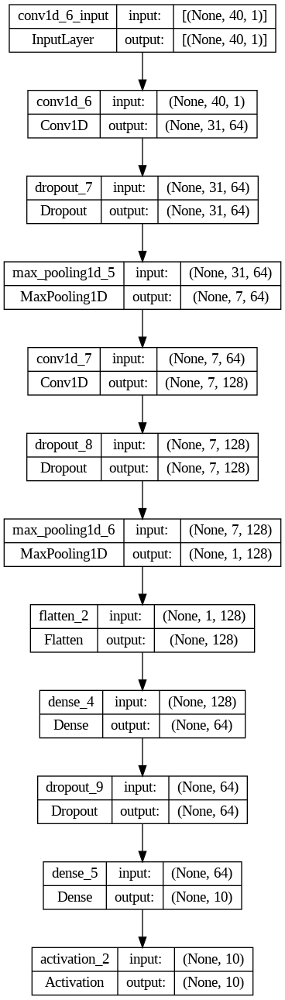

In [86]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model_architecture.png', show_shapes=True, show_layer_names=True)

In [87]:
num_epochs = 100
checkpointer = ModelCheckpoint(filepath='/content/checkpointer/best_weights.hdf5', verbose=1, save_best_only=True)
history = model.fit(X_train, y_train, batch_size=32, epochs=num_epochs, validation_data=(X_val, y_val), callbacks=[checkpointer], verbose=1)

Epoch 1/100
219/219 [==============================] - ETA: 0s - loss: 2.7711 - accuracy: 0.1453
Epoch 1: val_loss improved from inf to 2.22856, saving model to /content/checkpointer/best_weights.hdf5
219/219 [==============================] - 6s 7ms/step - loss: 2.7711 - accuracy: 0.1453 - val_loss: 2.2286 - val_accuracy: 0.2048
Epoch 2/100
206/219 [===========================>..] - ETA: 0s - loss: 2.1218 - accuracy: 0.2292
Epoch 2: val_loss improved from 2.22856 to 1.92557, saving model to /content/checkpointer/best_weights.hdf5
219/219 [==============================] - 1s 4ms/step - loss: 2.1156 - accuracy: 0.2308 - val_loss: 1.9256 - val_accuracy: 0.3730
Epoch 3/100
205/219 [===========================>..] - ETA: 0s - loss: 1.9606 - accuracy: 0.2991
Epoch 3: val_loss improved from 1.92557 to 1.79213, saving model to /content/checkpointer/best_weights.hdf5
219/219 [==============================] - 1s 4ms/step - loss: 1.9578 - accuracy: 0.3005 - val_loss: 1.7921 - val_accuracy: 0.4

In [89]:
score = model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test Acurracy:', score[1])

Test loss: 0.4285217821598053
Test Acurracy: 0.8820160627365112


In [90]:
score = model.evaluate(X_val, y_val, verbose=0)
print('Test loss:', score[0])
print('Test Acurracy:', score[1])

Test loss: 0.41758403182029724
Test Acurracy: 0.8752860426902771


In [91]:
history.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

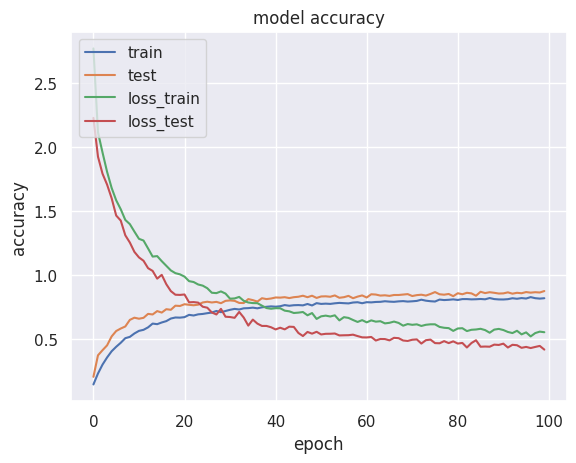

In [96]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test','loss_train','loss_test'], loc='upper left')